# HEMO dataset processing
- Sample: HEMO-d1-d32
- Author: Yiming Chao @HKU & CTSCB
- Update: 2025-7-11

In [1]:
import scanpy as sc
import anndata as ad
import pandas as pd

In [2]:
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80,dpi_save=100,color_map='Reds')
sc.logging.print_version_and_date()

import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib
plt.show()
matplotlib.rcParams.update({'figure.figsize': (6,6)})

Running Scanpy 1.10.3, on 2025-06-29 14:13.


# integrate HEMO

## prepare adata

In [3]:
adata_human_embryo = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/embryoX4_mnn.h5ad')

In [4]:
adata_hemo_d1_6 = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-bgi-d1-6-scvi-annotated-raw.h5ad')

In [5]:
adata_hemo_d4 = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-larry-d4-rna.h5ad')

In [6]:
adata_hemo_d12 = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-larry-d12-rna.h5ad')

In [7]:
adata_hemo_d8_18 = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo_res17_anno_3.h5ad')

In [8]:
adata_hemo_d24 = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d24-rna.h5ad')

In [9]:
adata_hemo_d32 = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d32-rna.h5ad')

In [10]:
adata_hemo_d1_6.obs['platform'] = 'BGI'
adata_hemo_d1_6.obs['orig.ident'] = 'HEMO'
adata_hemo_d1_6.obs['annotation'] = adata_hemo_d1_6.obs['label_v2']

In [11]:
adata_hemo_d4.obs['sample'] = 'd4'
adata_hemo_d4.obs['platform'] = '10x'
adata_hemo_d4.obs['orig.ident'] = 'HEMO'
adata_hemo_d4.obs['annotation'] = adata_hemo_d4.obs['celltype_v2']

In [12]:
adata_hemo_d12.obs['sample'] = 'd12'
adata_hemo_d12.obs['platform'] = '10x'
adata_hemo_d12.obs['orig.ident'] = 'HEMO'
adata_hemo_d12.obs['annotation'] = adata_hemo_d12.obs['celltype']

In [13]:
adata_hemo_d24.obs['sample'] = 'd24'
adata_hemo_d24.obs['platform'] = '10x'
adata_hemo_d24.obs['orig.ident'] = 'HEMO'
adata_hemo_d24.obs['annotation'] = adata_hemo_d24.obs['celltype']

In [14]:
adata_hemo_d8_18.obs['platform'] = '10x'
adata_hemo_d8_18.obs['orig.ident'] = 'HEMO'
adata_hemo_d8_18.obs['annotation'] = adata_hemo_d8_18.obs['celltype']
adata_hemo_d8_18.layers['counts'] = adata_hemo_d8_18.raw.X

sample_map = {'D08': 'd8', 'D15': 'd15', 'D18': 'd18'}
adata_hemo_d8_18.obs['sample'] = adata_hemo_d8_18.obs['sample'].map(lambda x: sample_map.get(x, x))

In [15]:
adata_hemo_d32.obs['sample'] = 'd32'
adata_hemo_d32.obs['platform'] = '10x'
adata_hemo_d32.obs['orig.ident'] = 'HEMO'
adata_hemo_d32.obs['annotation'] = adata_hemo_d32.obs['celltype']

In [16]:
adata = sc.concat([adata_hemo_d1_6, adata_hemo_d4, adata_hemo_d12, 
                   adata_hemo_d8_18, adata_hemo_d24, adata_hemo_d32])

/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/merge.py:1362: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [17]:
adata

AnnData object with n_obs × n_vars = 104876 × 16416
    obs: 'sample', 'celltype', 'platform', 'orig.ident', 'annotation'
    obsm: 'X_umap'
    layers: 'counts'

In [23]:
adata.X = adata.layers['counts']

In [24]:
adata.layers['counts'].max()

6034.0

In [22]:
adata.obs_names_make_unique()

In [25]:
adata.write_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-rna-uncorrected.h5ad')

## integration with scVI

In [1]:
import os
import tempfile

import scanpy as sc
import scvi
import seaborn as sns
import torch
import numpy as np
from rich import print
from scib_metrics.benchmark import Benchmarker
device = torch.device("cuda")

/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

In [3]:
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80,dpi_save=100,color_map='RdPu')
sc.logging.print_version_and_date()

import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib
plt.show()
matplotlib.rcParams.update({'figure.figsize': (6,6)})

Running Scanpy 1.10.3, on 2024-12-03 10:38.


In [31]:
adata = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-rna-uncorrected.h5ad')

In [32]:
adata.obs

,sample,celltype,platform,orig.ident,annotation
CELL3_N2,d1,Primitive Streak,BGI,HEMO,PS
CELL12_N2,d1,Primitive Streak,BGI,HEMO,PS
CELL13_N3,d1,Epiblast,BGI,HEMO,Epi
CELL19_N4,d1,Epiblast,BGI,HEMO,Epi
CELL28_N3,d1,Epiblast,BGI,HEMO,Epi
...,...,...,...,...,...
TTTGTTGCACGACGCT-1,d32,MC,10x,HEMO,MC
TTTGTTGCACGGGCTT-1,d32,MC,10x,HEMO,MC
TTTGTTGGTTAGGGTG-1,d32,MC,10x,HEMO,MC
TTTGTTGTCACTCGAA-1,d32,MC,10x,HEMO,MC


In [33]:
adata.obs['sample']

CELL3_N2               d1
CELL12_N2              d1
CELL13_N3              d1
CELL19_N4              d1
CELL28_N3              d1
                     ... 
TTTGTTGCACGACGCT-1    d32
TTTGTTGCACGGGCTT-1    d32
TTTGTTGGTTAGGGTG-1    d32
TTTGTTGTCACTCGAA-1    d32
TTTGTTGTCATTTGGG-1    d32
Name: sample, Length: 104876, dtype: category
Categories (12, object): ['d1', 'd2', 'd3', 'd4', ..., 'd15', 'd18', 'd24', 'd32']

In [27]:
adata.obs_names_make_unique()

In [30]:
adata.layers['counts']

<104876x16416 sparse matrix of type '<class 'numpy.float64'>'
	with 438137236 stored elements in Compressed Sparse Row format>

In [31]:
adata.X.shape

(104876, 16416)

In [32]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata  # freeze the state in `.raw`

normalizing counts per cell
    finished (0:00:01)


In [33]:
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=2000,
    layer="counts",
    batch_key="sample",
    subset=True,
)

extracting highly variable genes


/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:75: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [34]:
adata

AnnData object with n_obs × n_vars = 104876 × 2000
    obs: 'sample', 'celltype', 'platform', 'orig.ident', 'annotation'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg'
    obsm: 'X_umap'
    layers: 'counts'

In [35]:
scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="sample")
# scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="EmbryoIdent")
# scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key="EmbryoStage")

An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.
/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


In [36]:
model = scvi.model.SCVI(adata, n_layers=2, n_latent=30, gene_likelihood="nb")
# model = scvi.model.SCVI(adata, n_layers=2, n_latent=10, gene_likelihood="nb")

In [37]:
model.train()

Trainer will use only 1 of 3 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=3)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2]
/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:424: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=127` in the `DataLoader` to improve performance.


Epoch 76/76: 100%|██████████████████████████████████████| 76/76 [08:22<00:00,  6.64s/it, v_num=1, train_loss_step=602, train_loss_epoch=582]

`Trainer.fit` stopped: `max_epochs=76` reached.


Epoch 76/76: 100%|██████████████████████████████████████| 76/76 [08:22<00:00,  6.61s/it, v_num=1, train_loss_step=602, train_loss_epoch=582]


In [38]:
model_dir = os.path.join('/mnt/yiming/nfs_share/hema_wave/', "scvi_model_hemo-d1-32_241202-v1")
model.save(model_dir, overwrite=True)

In [39]:
model_dir

'/mnt/yiming/nfs_share/hema_wave/scvi_model_hemo-d1-32_241202-v1'

direct read the trained model

In [40]:
model_dir = os.path.join('/mnt/yiming/nfs_share/hema_wave/', "scvi_model_hemo-d1-32_241202-v1")
model = scvi.model.SCVI.load(model_dir, adata=adata)

Trainer will use only 1 of 3 GPUs because it is running inside an interactive / notebook environment. You may try to set `Trainer(devices=3)` but please note that multi-GPU inside interactive / notebook environments is considered experimental and unstable. Your mileage may vary.


INFO     File /mnt/yiming/nfs_share/hema_wave/scvi_model_hemo-d1-32_241202-v1/model.pt already downloaded          


/mnt/yiming/nfs_share/anaconda3/envs/scvi-env/lib/python3.9/site-packages/scvi/model/base/_utils.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(mode

In [41]:
model

SCVI model with the following parameters: 
n_hidden: 128, n_latent: 30, n_layers: 2, dropout_rate: 0.1, dispersion: gene, gene_likelihood: nb, 
latent_distribution: normal.
Training status: Trained
Model's adata is minified?: False

In [42]:
SCVI_LATENT_KEY = "X_scVI"

latent = model.get_latent_representation()
adata.obsm[SCVI_LATENT_KEY] = latent
latent.shape

(104876, 30)

In [44]:
# run PCA then generate UMAP plots
sc.tl.pca(adata)
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=20)
sc.tl.umap(adata, min_dist=0.3)

computing PCA
    with n_comps=50
    finished (0:00:22)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:35)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:07)


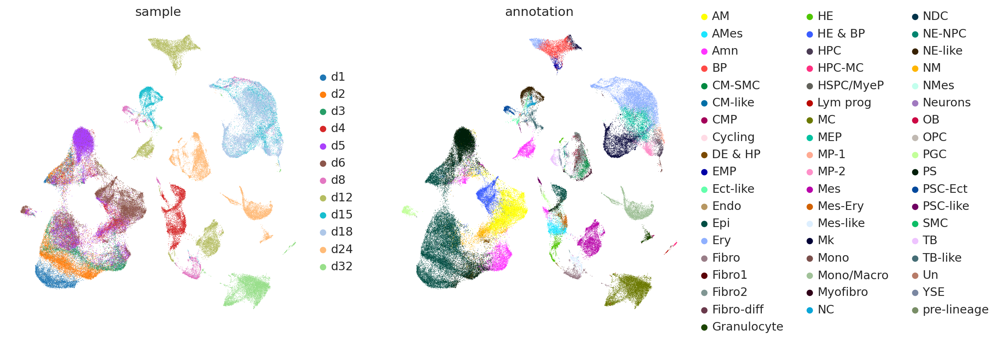

In [45]:
sc.pl.umap(
    adata,
    color=["sample", "annotation"],
    frameon=False)

In [71]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata, 
                n_pcs=20,
                n_neighbors=60, 
                use_rep=SCVI_LATENT_KEY)
sc.tl.umap(adata, 
           min_dist=0.2)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:49)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:32)


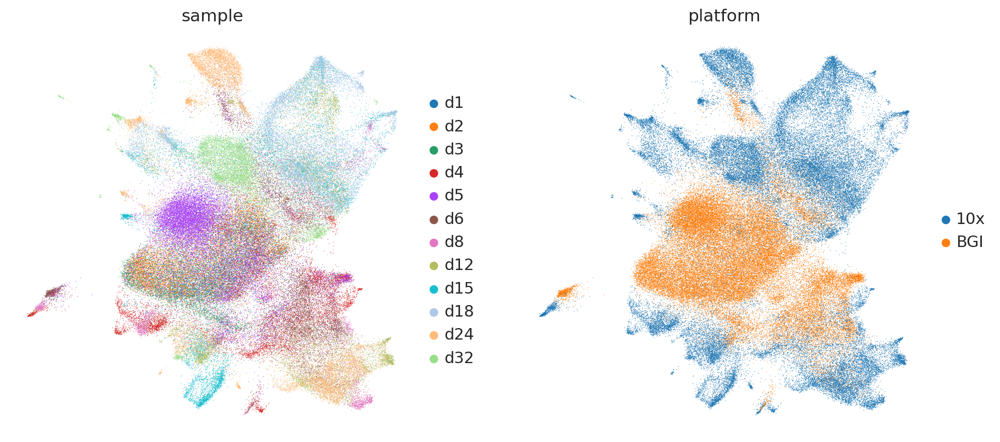

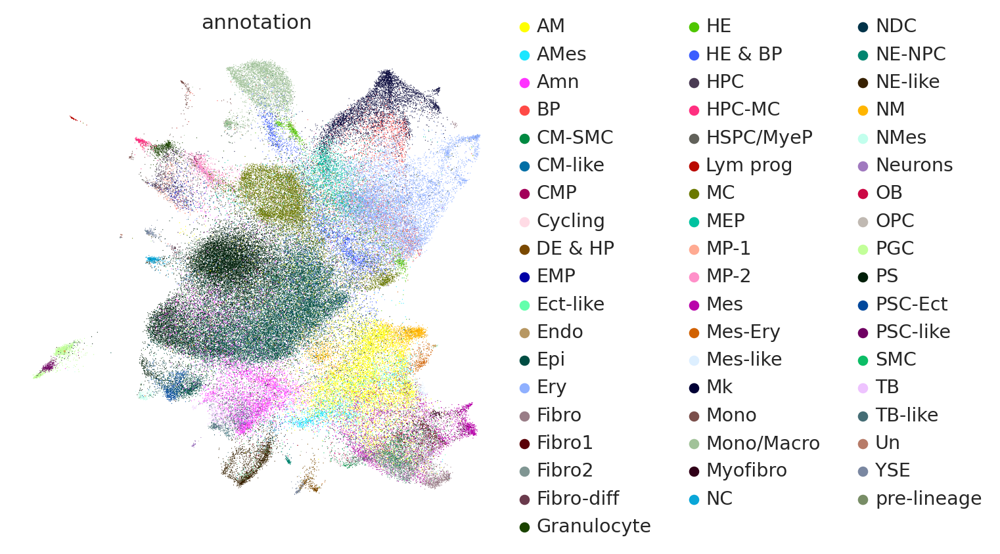

In [72]:
sc.pl.umap(adata, color=["sample", "platform"], frameon=False)
sc.pl.umap(adata, color=["annotation"], frameon=False)

In [73]:
adata

AnnData object with n_obs × n_vars = 104876 × 2000
    obs: 'sample', 'celltype', 'platform', 'orig.ident', 'annotation', '_scvi_batch', '_scvi_labels'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'hvg', '_scvi_uuid', '_scvi_manager_uuid', 'pca', 'neighbors', 'umap', 'sample_colors', 'annotation_colors', 'platform_colors'
    obsm: 'X_umap', 'X_scVI', 'X_pca'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [74]:
adata.obs['day'] = pd.to_numeric(adata.obs['sample'].str.replace('d', ''))

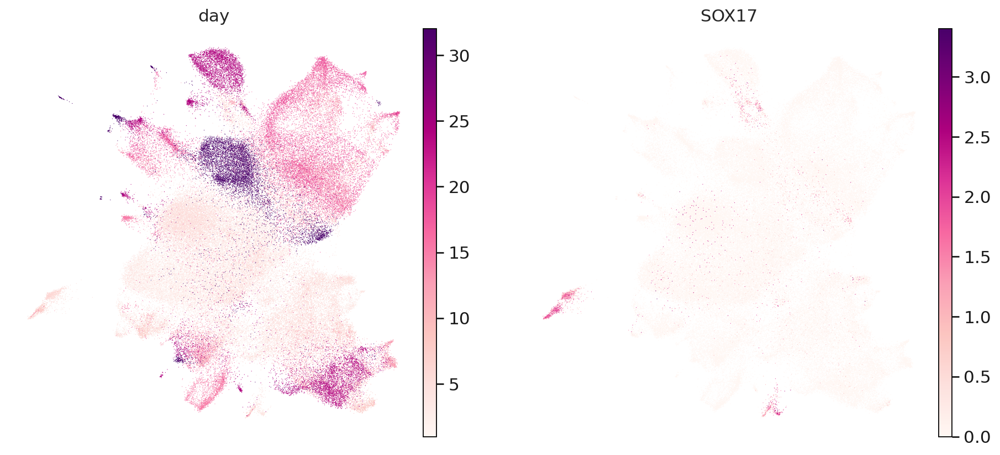

In [83]:
sc.pl.umap(adata, color=["day", "SOX17"], frameon=False)

In [29]:
adata.write_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

# celltypist

In [1]:
import scanpy as sc
import celltypist
from celltypist import models
import time
import numpy as np
import pandas as pd

In [2]:
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80,dpi_save=100,color_map='Reds')
sc.logging.print_version_and_date()

import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib
plt.show()
matplotlib.rcParams.update({'figure.figsize': (6,6)})

Running Scanpy 1.10.3, on 2024-12-10 12:17.


In [3]:
adata = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

In [4]:
adata = adata.raw.to_adata()
sc.pp.normalize_total(adata, target_sum = 1e4) #Note this is only for cell annotation, recommended by authors but not best
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:01)


In [5]:
Tyser_model = models.Model.load(model="/mnt/yiming/nfs_share/hema_wave/Tyser_model.pkl")

In [6]:
predictions = celltypist.annotate(adata, model=Tyser_model, majority_voting=True)
predictions_adata = predictions.to_adata()
adata.obs["Tyser_label"] = predictions_adata.obs.loc[adata.obs.index, "predicted_labels"]
adata.obs["Tyser_score"] = predictions_adata.obs.loc[adata.obs.index, "conf_score"]

🔬 Input data has 104876 cells and 16416 genes
🔗 Matching reference genes in the model
🧬 2515 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25


running Leiden clustering


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


    finished: found 471 clusters and added
    'over_clustering', the cluster labels (adata.obs, categorical) (0:23:32)


🗳️ Majority voting the predictions
✅ Majority voting done!


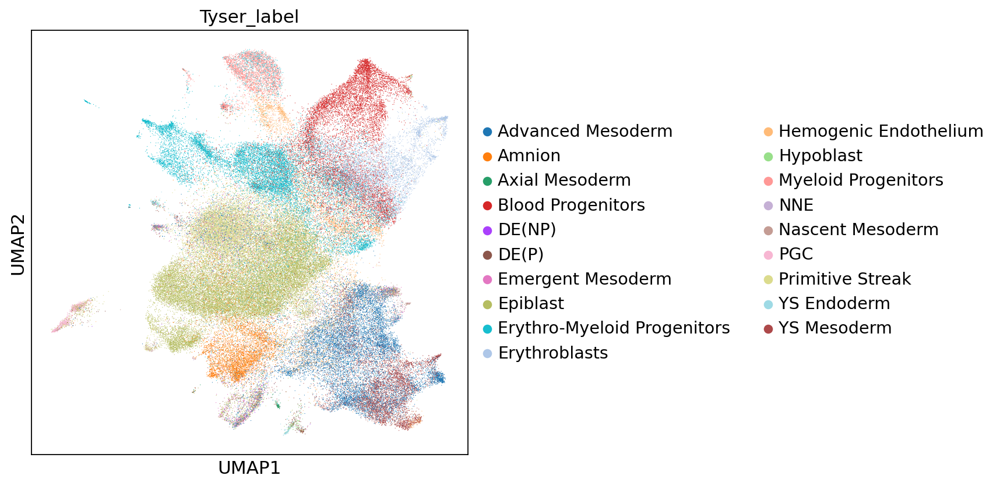

In [7]:
sc.pl.umap(adata, color=['Tyser_label'])

In [8]:
adata.write_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

In [9]:
Tyser_model_v2 = models.Model.load(model="/mnt/yiming/nfs_share/hema_wave/Tyser_model_v2.pkl")

In [10]:
predictions = celltypist.annotate(adata, model=Tyser_model_v2, majority_voting=True)
predictions_adata = predictions.to_adata()
adata.obs["Tyser_label_v2"] = predictions_adata.obs.loc[adata.obs.index, "predicted_labels"]
adata.obs["Tyser_score_v2"] = predictions_adata.obs.loc[adata.obs.index, "conf_score"]

🔬 Input data has 104876 cells and 16416 genes
🔗 Matching reference genes in the model
🧬 2044 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25


running Leiden clustering
    finished: found 471 clusters and added
    'over_clustering', the cluster labels (adata.obs, categorical) (0:23:22)


🗳️ Majority voting the predictions
✅ Majority voting done!


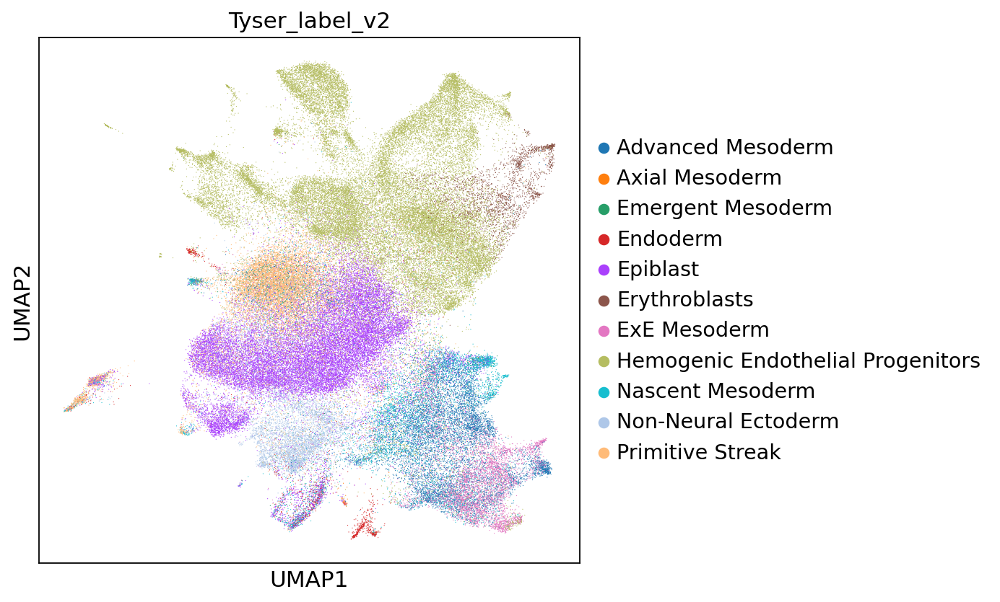

In [11]:
sc.pl.umap(adata, color=['Tyser_label_v2'])

In [12]:
adata.write_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

In [13]:
Ng_model = models.Model.load(model="/mnt/yiming/nfs_share/hema_wave/Ng-iHSC-5k_model.pkl")

In [14]:
predictions = celltypist.annotate(adata, model=Ng_model, majority_voting=True)
predictions_adata = predictions.to_adata()
adata.obs["Ng_label"] = predictions_adata.obs.loc[adata.obs.index, "predicted_labels"]
adata.obs["Ng_score"] = predictions_adata.obs.loc[adata.obs.index, "conf_score"]

🔬 Input data has 104876 cells and 16416 genes
🔗 Matching reference genes in the model
🧬 4065 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25


running Leiden clustering


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


    finished: found 471 clusters and added
    'over_clustering', the cluster labels (adata.obs, categorical) (0:23:15)


🗳️ Majority voting the predictions
✅ Majority voting done!


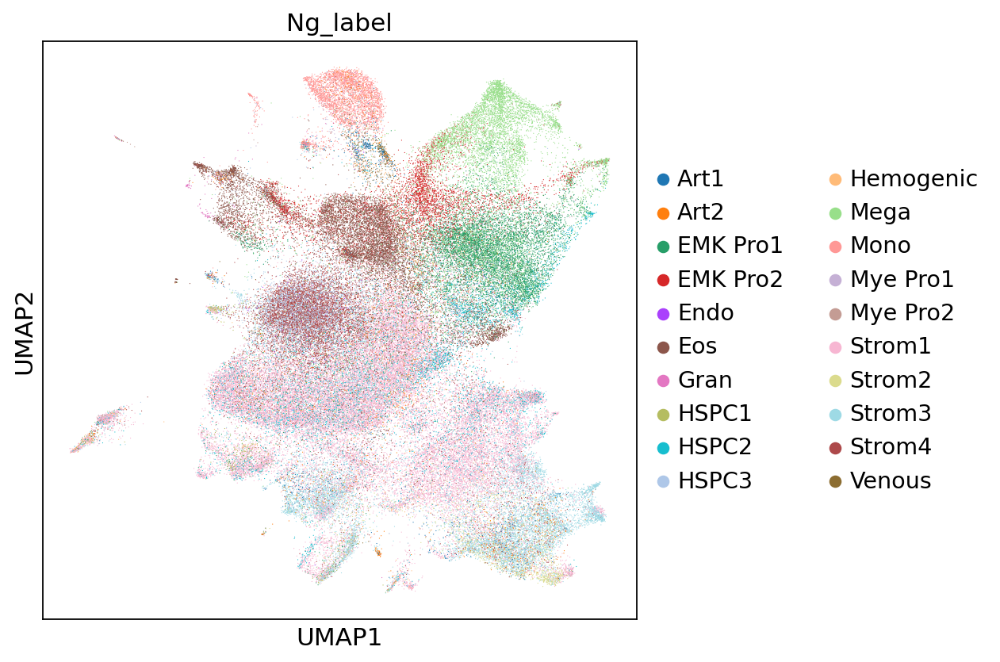

In [15]:
sc.pl.umap(adata, color=['Ng_label'])

In [16]:
adata.write_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

In [17]:
Luff_model = models.Model.load(model="/mnt/yiming/nfs_share/hema_wave/Luff_model.pkl")

In [18]:
predictions = celltypist.annotate(adata, model=Luff_model, majority_voting=True)
predictions_adata = predictions.to_adata()
adata.obs["Luff_label"] = predictions_adata.obs.loc[adata.obs.index, "predicted_labels"]
adata.obs["Luff_score"] = predictions_adata.obs.loc[adata.obs.index, "conf_score"]

🔬 Input data has 104876 cells and 16416 genes
🔗 Matching reference genes in the model
🧬 1660 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 25


running Leiden clustering


IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


    finished: found 471 clusters and added
    'over_clustering', the cluster labels (adata.obs, categorical) (0:23:33)


🗳️ Majority voting the predictions
✅ Majority voting done!


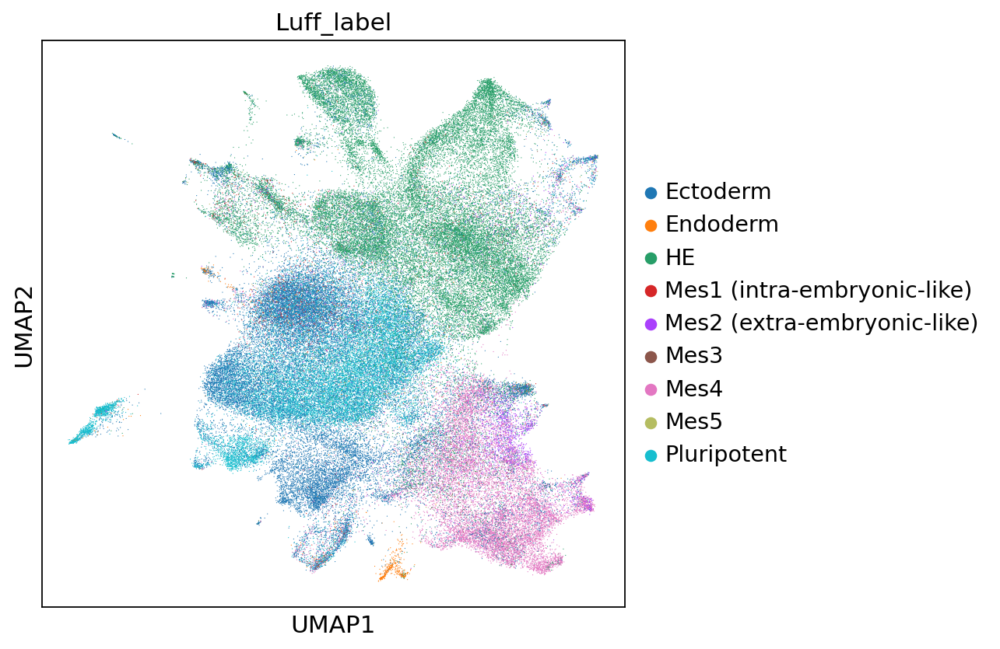

In [19]:
sc.pl.umap(adata, color=['Luff_label'])

In [20]:
adata.write_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

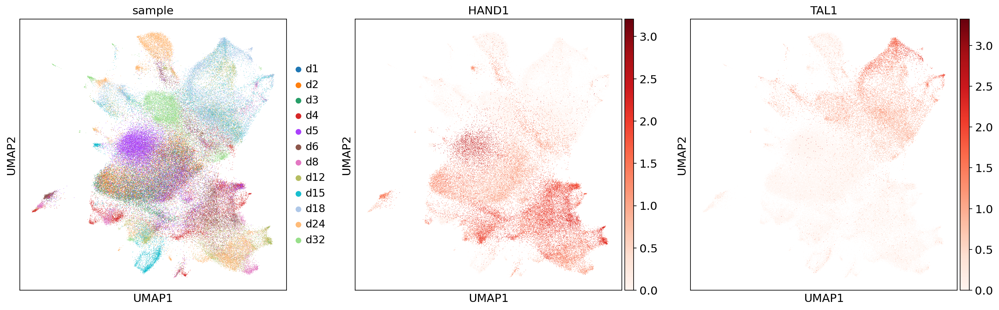

In [24]:
sc.pl.umap(adata, color=['sample', 'HAND1', 'TAL1'])

# check adata

In [1]:
import scanpy as sc
import celltypist
from celltypist import models
import time
import numpy as np
import pandas as pd

In [2]:
sc.settings.verbosity = 3
sc.settings.set_figure_params(dpi=80,dpi_save=100,color_map='Reds')
sc.logging.print_version_and_date()

import matplotlib.pyplot as plt
from matplotlib import rcParams
import matplotlib
plt.show()
matplotlib.rcParams.update({'figure.figsize': (6,6)})

Running Scanpy 1.10.3, on 2025-07-11 07:42.


In [3]:
adata = sc.read_h5ad('/mnt/yiming/nfs_share/hema_wave/hemo-d1-32-scvi-integrated.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 104876 × 16416
    obs: 'sample', 'celltype', 'platform', 'orig.ident', 'annotation', '_scvi_batch', '_scvi_labels', 'day', 'predicted_labels', 'majority_voting', 'conf_score', 'Tyser_label', 'Tyser_score', 'Tyser_label_v2', 'Tyser_score_v2', 'Ng_label', 'Ng_score', 'over_clustering', 'Luff_label', 'Luff_score'
    uns: 'Luff_label_colors', 'Ng_label_colors', 'Tyser_label_colors', 'Tyser_label_v2_colors', '_scvi_manager_uuid', '_scvi_uuid', 'annotation_colors', 'hvg', 'log1p', 'neighbors', 'over_clustering', 'pca', 'platform_colors', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    obsp: 'connectivities', 'distances'

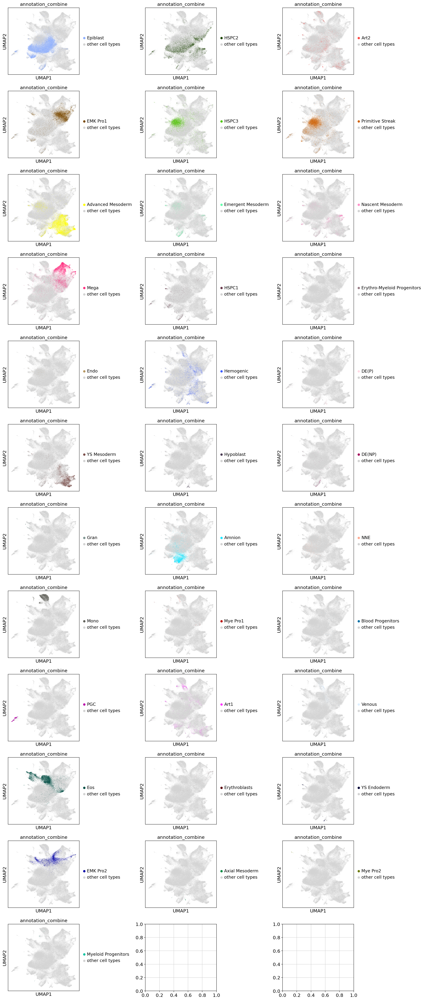

In [9]:
label_present = adata.obs['annotation_combine'].unique()
num_plots = len(label_present)
num_cols = 3
num_rows = -(-num_plots // num_cols) 

fig_width = num_cols * 6 
fig_height = num_rows * 3.5
fig, axs = plt.subplots(num_rows, num_cols, figsize=(fig_width, fig_height))

for i, label in enumerate(label_present):
    row = i // num_cols
    col = i % num_cols
    ax = axs[row, col]

    sc.pl.umap(adata, color=["annotation_combine"], groups=[label], show=False, ax=ax)

    legend_texts = ax.get_legend().get_texts()
    for legend_text in legend_texts:
        if legend_text.get_text() == "NA":
            legend_text.set_text("other cell types")

    ax.set_aspect('auto', adjustable='box', anchor='C')

plt.tight_layout()
plt.show()

In [6]:
adata

AnnData object with n_obs × n_vars = 104876 × 16416
    obs: 'sample', 'celltype', 'platform', 'orig.ident', 'annotation', '_scvi_batch', '_scvi_labels', 'day', 'predicted_labels', 'majority_voting', 'conf_score', 'Tyser_label', 'Tyser_score', 'Tyser_label_v2', 'Tyser_score_v2', 'Ng_label', 'Ng_score', 'over_clustering', 'Luff_label', 'Luff_score'
    uns: 'Luff_label_colors', 'Ng_label_colors', 'Tyser_label_colors', 'Tyser_label_v2_colors', '_scvi_manager_uuid', '_scvi_uuid', 'annotation_colors', 'hvg', 'log1p', 'neighbors', 'over_clustering', 'pca', 'platform_colors', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    obsp: 'connectivities', 'distances'

In [8]:
adata.obs['sample']

CELL3_N2               d1
CELL12_N2              d1
CELL13_N3              d1
CELL19_N4              d1
CELL28_N3              d1
                     ... 
TTTGTTGCACGACGCT-1    d32
TTTGTTGCACGGGCTT-1    d32
TTTGTTGGTTAGGGTG-1    d32
TTTGTTGTCACTCGAA-1    d32
TTTGTTGTCATTTGGG-1    d32
Name: sample, Length: 104876, dtype: category
Categories (12, object): ['d1', 'd2', 'd3', 'd4', ..., 'd15', 'd18', 'd24', 'd32']

In [9]:
adata_sub = adata[~adata.obs['sample'].isin(['d15', 'd18', 'd24', 'd32'])]

In [10]:
adata_sub

View of AnnData object with n_obs × n_vars = 68793 × 16416
    obs: 'sample', 'celltype', 'platform', 'orig.ident', 'annotation', '_scvi_batch', '_scvi_labels', 'day', 'predicted_labels', 'majority_voting', 'conf_score', 'Tyser_label', 'Tyser_score', 'Tyser_label_v2', 'Tyser_score_v2', 'Ng_label', 'Ng_score', 'over_clustering', 'Luff_label', 'Luff_score'
    uns: 'Luff_label_colors', 'Ng_label_colors', 'Tyser_label_colors', 'Tyser_label_v2_colors', '_scvi_manager_uuid', '_scvi_uuid', 'annotation_colors', 'hvg', 'log1p', 'neighbors', 'over_clustering', 'pca', 'platform_colors', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_scVI', 'X_umap'
    obsp: 'connectivities', 'distances'

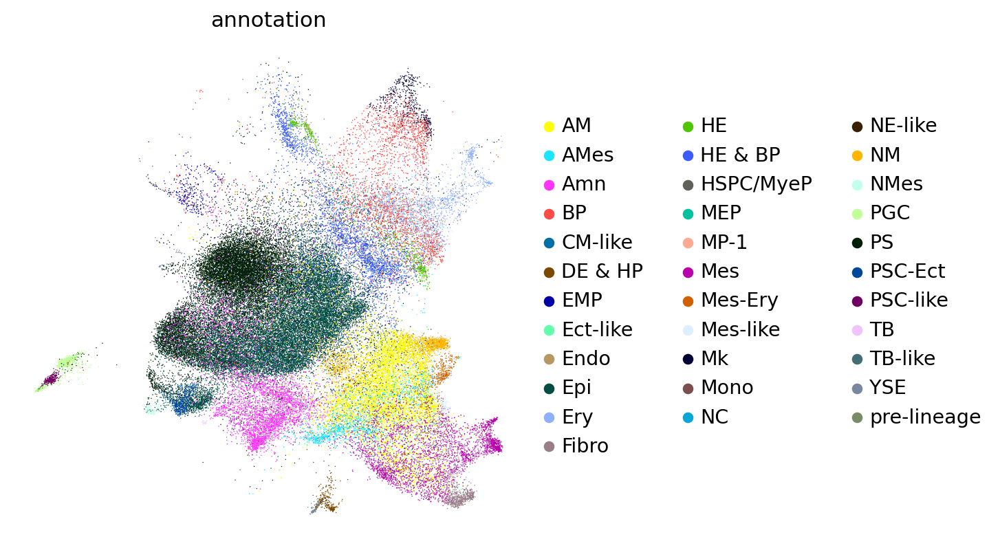

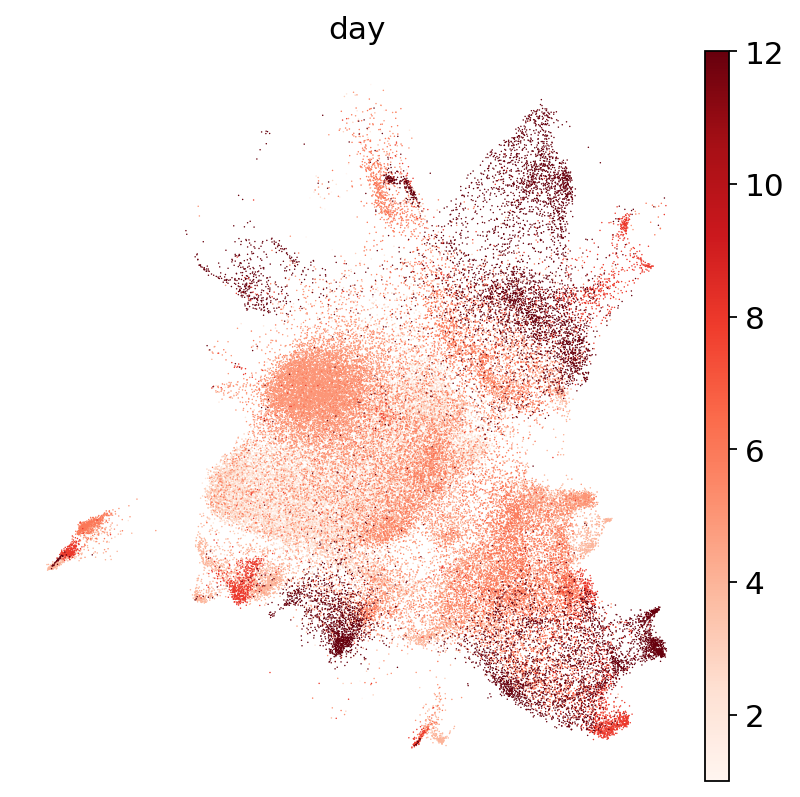

In [12]:
sc.pl.umap(adata_sub, color=['annotation'], frameon=False)
sc.pl.umap(adata_sub, color=['day'], frameon=False)

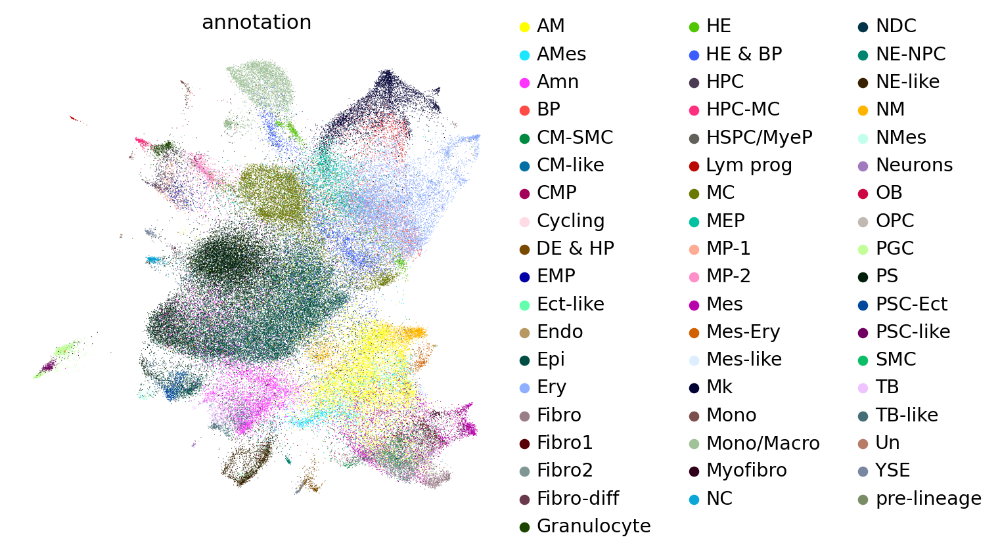

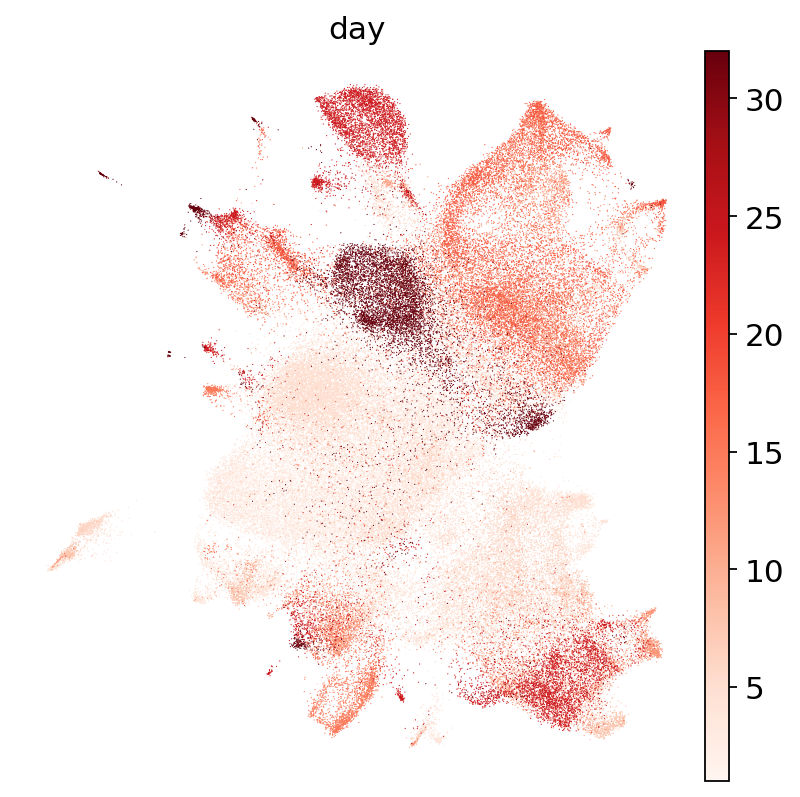

In [13]:
sc.pl.umap(adata, color=['annotation'], frameon=False)
sc.pl.umap(adata, color=['day'], frameon=False)

In [6]:
def replace_ng_label(row):
    if row['Ng_label'] in ['Strom1', 'Strom2', 'Strom3', 'Strom4']:
        return row['Tyser_label']
    else:
        return row['Ng_label']

# Apply the custom function to create the new column 'annotation_combine'
adata.obs['annotation_combine'] = adata.obs.apply(replace_ng_label, axis=1)
adata.obs['annotation_combine'] = adata.obs['annotation_combine'].replace('Hemogenic Endothelium', 'Hemogenic')

In [25]:
def replace_ng_label(row):
    if row['Ng_label'] in ['Strom1', 'Strom2', 'Strom3', 'Strom4']:
        return row['Tyser_label']
    else:
        return row['Ng_label']

# Apply the custom function to create the new column 'annotation_combine'
adata_sub.obs['annotation_combine'] = adata_sub.obs.apply(replace_ng_label, axis=1)
adata_sub.obs['annotation_combine'] = adata_sub.obs['annotation_combine'].replace('Hemogenic Endothelium', 'Hemogenic')

... storing 'annotation_combine' as categorical


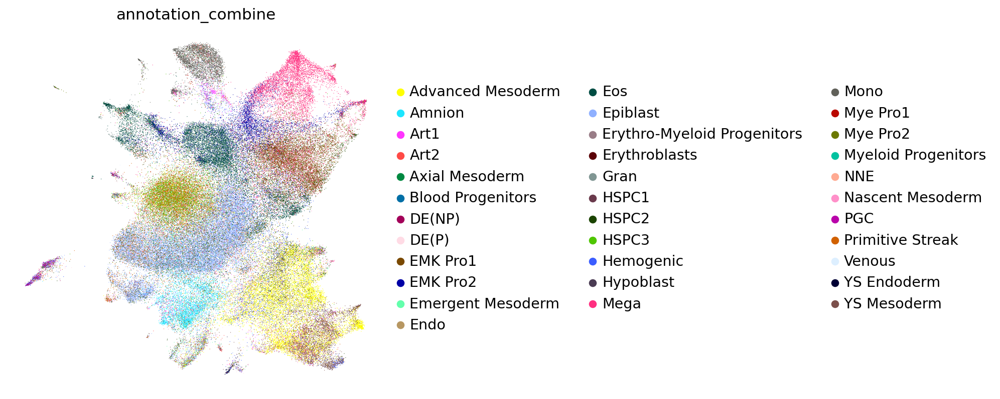

In [29]:
sc.pl.umap(adata, color=['annotation_combine'], frameon=False)

... storing 'annotation_combine' as categorical


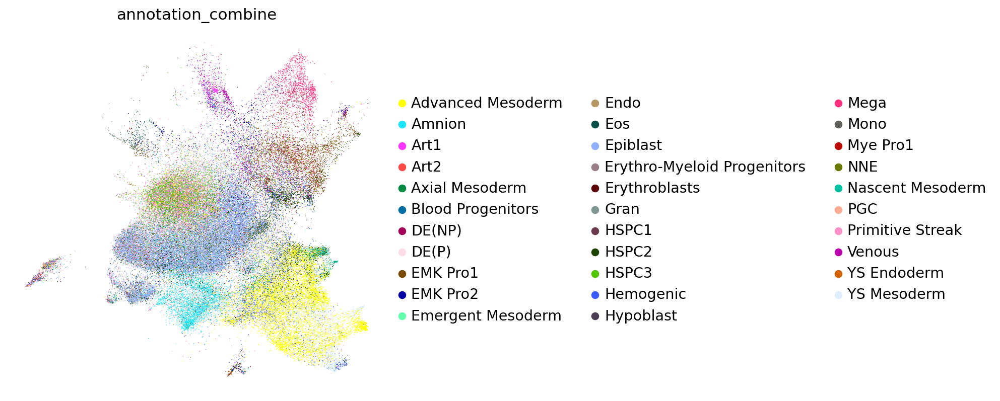

In [26]:
sc.pl.umap(adata_sub, color=['annotation_combine'], frameon=False)

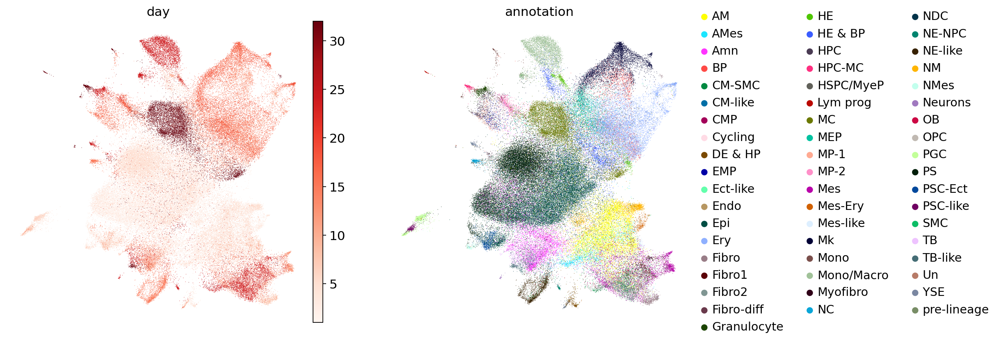

In [10]:
sc.pl.umap(adata, color=["day", 'annotation'], frameon=False)